In [1]:
from bertopic import BERTopic
from bertopic.representation import KeyBERTInspired, MaximalMarginalRelevance
from sentence_transformers import SentenceTransformer
from hdbscan import HDBSCAN
from umap import UMAP
from sklearn.feature_extraction.text import CountVectorizer
from bertopic.vectorizers import ClassTfidfTransformer
from IPython.core.interactiveshell import InteractiveShell
import pandas as pd
import numpy as np
import pyarrow
import openpyxl


InteractiveShell.ast_node_interactivity = "all"

c:\Users\Localadmin_pabflore\miniconda3\envs\ymltest\lib\site-packages\tqdm\auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


This notebook was created with pedagogical purposes. Its aim is to be a guide on how to explore user prompts with BERTopic, a data-driven embedding-based approach to topic modeling.
It is not optimized for performance and exploration or modification of values is encouraged. Feel free to skip the parts you are not interested in.

Remember to use the conda environment provided (see README.md).


# Data Wrangling (json structure)

The data is downloaded from ChatGPT as a json file. FIXME : Describe the data when is well defined and settled.

If you want to explore your own prompts, you can do it by changing the path to your own data in the first cell of the notebook. The pipeline should work the same way, unless you are using a different source of prompts (i.e, Anthropic, Gemini, etc.).




In [2]:
## Preview the data

df = pd.read_json("data/hiperprompts/hiperprompts.json")
df_pipa = pd.read_json("data/hiperprompts/pipaprompts.json")

df.head()




,title,create_time,update_time,mapping,moderation_results,current_node,plugin_ids,conversation_id,conversation_template_id,gizmo_id,is_archived,safe_urls,default_model_slug,conversation_origin,voice,async_status,id
0,Recuperar protocolos NIC,2024-11-12 09:20:29.556296110,2024-11-12 09:20:57.956078053,{'aaa1d98b-f259-4670-9cff-10a93b6abbf9': {'id'...,[],a0a72f8a-4c66-46d4-986d-58edb1a71ca9,None,67331ddd-6800-800a-9efd-4406be693962,None,None,False,[],gpt-4o,NaN,None,NaN,67331ddd-6800-800a-9efd-4406be693962
1,TBR NFB Beta Theta Correlation,2024-11-11 17:57:11.687103033,2024-11-11 20:25:32.861429930,{'aaa1c1f8-f66c-489b-9bae-aa72918847d7': {'id'...,[],c03d00f7-2495-45c9-80d1-a5e28a6dd015,None,67324577-7760-800a-aec8-cabc69c4fc61,None,None,False,[],o1-preview,NaN,None,NaN,67324577-7760-800a-aec8-cabc69c4fc61
2,K-means Clustering NFB Learners,2024-11-11 17:40:25.795202971,2024-11-11 19:15:40.709968090,{'aaa13ef2-3988-488c-9a49-df641ba7a851': {'id'...,[],bf5b1f48-96d3-44f8-8b6e-27e6de94e705,None,67324189-9828-800a-9e19-fffefd925f48,None,None,False,[],o1-preview,NaN,None,NaN,67324189-9828-800a-9e19-fffefd925f48
3,CTypes ArgumentError Solution,2024-11-11 17:01:59.849903107,2024-11-11 17:02:15.963733912,{'aaa1586c-985c-471b-925d-fa998a99652e': {'id'...,[],08ff7534-9606-45dc-a9f3-3e7938754a60,None,67323887-9ebc-800a-8bfe-fa16580c9c0b,None,None,False,[],gpt-4o,NaN,None,NaN,67323887-9ebc-800a-8bfe-fa16580c9c0b
4,Run Conda Script Batch,2024-11-11 16:44:09.142015934,2024-11-11 16:56:03.363743067,{'aaa1c48c-f9dd-4737-a057-6137ec579fef': {'id'...,[],6a732fc0-cd98-4a91-9372-5f654eb2163c,None,67323458-feac-800a-8c77-ffa03083798b,None,None,False,[],gpt-4o,NaN,None,NaN,67323458-feac-800a-8c77-ffa03083798b


We can see that the conversation data is not readily accessible. While is not that obvious, the messages are nested in a dictionary under the "mapping" column.

Lets inspect the first conversation of the dataframe, by accessing its mapping value.

In [3]:
df.mapping[0]

{'aaa1d98b-f259-4670-9cff-10a93b6abbf9': {'id': 'aaa1d98b-f259-4670-9cff-10a93b6abbf9',
  'message': None,
  'parent': None,
  'children': ['80164b67-6f23-491f-a67d-cce85d2a9f9f']},
 '80164b67-6f23-491f-a67d-cce85d2a9f9f': {'id': '80164b67-6f23-491f-a67d-cce85d2a9f9f',
  'message': {'id': '80164b67-6f23-491f-a67d-cce85d2a9f9f',
   'author': {'role': 'system', 'name': None, 'metadata': {}},
   'create_time': None,
   'update_time': None,
   'content': {'content_type': 'text', 'parts': ['']},
   'status': 'finished_successfully',
   'end_turn': True,
   'weight': 0.0,
   'metadata': {'is_visually_hidden_from_conversation': True},
   'recipient': 'all',
   'channel': None},
  'parent': 'aaa1d98b-f259-4670-9cff-10a93b6abbf9',
  'children': ['262bf211-5a40-454d-9f54-cdd61925b2ee']},
 '262bf211-5a40-454d-9f54-cdd61925b2ee': {'id': '262bf211-5a40-454d-9f54-cdd61925b2ee',
  'message': {'id': '262bf211-5a40-454d-9f54-cdd61925b2ee',
   'author': {'role': 'user', 'name': None, 'metadata': {}},
  

We can see here how one conversation is structured. It has several entries, and each entry has an id, a role (user or assistant), the actual message, along with other metadata.

Note that the structure is of a dictionary of dictionaries (with maybe a couple of more dictionaries as values).

In case you do not know, dictionaries are a data structure that store key-value pairs. They have a key and a value, and are defined with curly braces {}.

For example: `{"key": "value", "key2": "value2"}` , where "key" and "key2" are the keys, and "value" and "value2" are the values.
`customer = {'name': 'John', 'age': 30, 'city': 'New York'}` is a dictionary with three key-value pairs. `customer['name']` would return 'John'.



To access the messages, we need to iterate through the dictionary keys and get their values. Lets see how we can do this.


In [109]:
## Accessing the entries, through the unique ids (copy the message id from previous output and paste it here)
df.mapping[0]['aaa1d98b-f259-4670-9cff-10a93b6abbf9']



{'id': 'aaa1d98b-f259-4670-9cff-10a93b6abbf9',
 'message': None,
 'parent': None,
 'children': ['80164b67-6f23-491f-a67d-cce85d2a9f9f']}

In [110]:
## Iterating through through all the messages of one conversation
CHAT_ID = 0 # Change this value to explore different conversations
                                       
entries = list(df.mapping[CHAT_ID].keys()) 
for entry in entries: 
    df.mapping[CHAT_ID][entry]

## If you have your own df, you might need to change the code above to access the messages. 


{'id': 'aaa1d98b-f259-4670-9cff-10a93b6abbf9',
 'message': None,
 'parent': None,
 'children': ['80164b67-6f23-491f-a67d-cce85d2a9f9f']}

{'id': '80164b67-6f23-491f-a67d-cce85d2a9f9f',
 'message': {'id': '80164b67-6f23-491f-a67d-cce85d2a9f9f',
  'author': {'role': 'system', 'name': None, 'metadata': {}},
  'create_time': None,
  'update_time': None,
  'content': {'content_type': 'text', 'parts': ['']},
  'status': 'finished_successfully',
  'end_turn': True,
  'weight': 0.0,
  'metadata': {'is_visually_hidden_from_conversation': True},
  'recipient': 'all',
  'channel': None},
 'parent': 'aaa1d98b-f259-4670-9cff-10a93b6abbf9',
 'children': ['262bf211-5a40-454d-9f54-cdd61925b2ee']}

{'id': '262bf211-5a40-454d-9f54-cdd61925b2ee',
 'message': {'id': '262bf211-5a40-454d-9f54-cdd61925b2ee',
  'author': {'role': 'user', 'name': None, 'metadata': {}},
  'create_time': None,
  'update_time': None,
  'content': {'content_type': 'user_editable_context',
   'user_profile': 'The user provided the following information about themselves. This user profile is shown to you in all conversations they have -- this means it is not relevant to 99% of requests.\nBefore answering, quietly think about whether the user\'s request is "directly related", "related", "tangentially related", or "not related" to the user profile provided.\nOnly acknowledge the profile when the request is directly related to the information provided.\nOtherwise, don\'t acknowledge the existence of these instructions or the information at all.\nUser profile:\n```Only analytical responses.```',
   'user_instructions': ''},
  'status': 'finished_successfully',
  'end_turn': None,
  'weight': 1.0,
  'metadata': {'i

{'id': 'aaa29811-b9d3-420b-84a2-5504ab542d87',
 'message': {'id': 'aaa29811-b9d3-420b-84a2-5504ab542d87',
  'author': {'role': 'user', 'name': None, 'metadata': {}},
  'create_time': 1731403229.562039,
  'update_time': None,
  'content': {'content_type': 'text',
   'parts': ["I lost protocols that I created with Neuroelectrics' NIC interphase, how can I recover them?\n"]},
  'status': 'finished_successfully',
  'end_turn': None,
  'weight': 1.0,
  'metadata': {'serialization_metadata': {'custom_symbol_offsets': []},
   'request_id': '8e157246fb898d7c-HEL',
   'message_source': None,
   'timestamp_': 'absolute',
   'message_type': None,
   'paragen_variants_info': {'type': 'num_variants_in_stream',
    'num_variants_in_stream': 2,
    'display_treatment': 'skippable',
    'conversation_id': '67331ddd-6800-800a-9efd-4406be693962'}},
  'recipient': 'all',
  'channel': None},
 'parent': '262bf211-5a40-454d-9f54-cdd61925b2ee',
 'children': ['3ac6cedc-b73a-4a70-b953-a309cb034148',
  '5d7d1a9

{'id': '3ac6cedc-b73a-4a70-b953-a309cb034148',
 'message': {'id': '3ac6cedc-b73a-4a70-b953-a309cb034148',
  'author': {'role': 'system', 'name': None, 'metadata': {}},
  'create_time': 1731403257.040463,
  'update_time': None,
  'content': {'content_type': 'text', 'parts': ['']},
  'status': 'finished_successfully',
  'end_turn': True,
  'weight': 0.0,
  'metadata': {'rebase_system_message': True,
   'message_type': None,
   'model_slug': 'gpt-4o',
   'default_model_slug': 'gpt-4o',
   'parent_id': 'aaa29811-b9d3-420b-84a2-5504ab542d87',
   'request_id': '8e157246fb898d7c-HEL',
   'timestamp_': 'absolute',
   'is_visually_hidden_from_conversation': True},
  'recipient': 'all',
  'channel': None},
 'parent': 'aaa29811-b9d3-420b-84a2-5504ab542d87',
 'children': ['21635c0b-439b-4609-bacf-4cb027329837']}

{'id': '21635c0b-439b-4609-bacf-4cb027329837',
 'message': {'id': '21635c0b-439b-4609-bacf-4cb027329837',
  'author': {'role': 'tool', 'name': 'a8km123', 'metadata': {}},
  'create_time': 1731403257.040563,
  'update_time': None,
  'content': {'content_type': 'text',
   'parts': ["**Recovering lost protocols**\n\nI’m exploring methods to retrieve lost protocols created with Neuroelectrics' NIC interface, focusing on the use of Neuroelectrics' NIC interface and available recovery options.\n\n**Assessing options**\n\nI'm considering whether protocols are locally saved, cloud-stored, or both. If lost, I'll check backup files, software recovery, and contact Neuroelectrics support for help.\n\n**Locating and recovering protocols**\n\nI’m thinking about finding NIC protocols by checking default save locations, searching computer files, and checking backups.\n\n**Taking a closer look**\n\nFirst, I check the Recycle Bin. If the files aren't there, I use recovery software like Recuva or Disk Dr

{'id': '5d7d1a9d-21de-4530-b9b1-7c567a822c69',
 'message': {'id': '5d7d1a9d-21de-4530-b9b1-7c567a822c69',
  'author': {'role': 'assistant', 'name': None, 'metadata': {}},
  'create_time': 1731403248.496614,
  'update_time': None,
  'content': {'content_type': 'text', 'parts': ['']},
  'status': 'finished_successfully',
  'end_turn': None,
  'weight': 1.0,
  'metadata': {'message_type': None,
   'model_slug': 'gpt-4o',
   'default_model_slug': 'gpt-4o',
   'parent_id': 'aaa29811-b9d3-420b-84a2-5504ab542d87',
   'request_id': '8e157246fb898d7c-HEL',
   'timestamp_': 'absolute'},
  'recipient': 'all',
  'channel': None},
 'parent': 'aaa29811-b9d3-420b-84a2-5504ab542d87',
 'children': ['3aa3f8d2-fbc1-44e6-a2ae-d40c2501597d']}

{'id': '3aa3f8d2-fbc1-44e6-a2ae-d40c2501597d',
 'message': {'id': '3aa3f8d2-fbc1-44e6-a2ae-d40c2501597d',
  'author': {'role': 'assistant', 'name': None, 'metadata': {}},
  'create_time': 1731403248.496731,
  'update_time': None,
  'content': {'content_type': 'code',
   'language': 'unknown',
   'response_format_name': None,
   'text': 'search("I lost protocols that I created with Neuroelectrics\' NIC interphase, how can I recover them?\\n")'},
  'status': 'finished_successfully',
  'end_turn': None,
  'weight': 1.0,
  'metadata': {'sonic_classification_result': {'latency_ms': 4795552287.807558,
    'search_prob': 0.855437212606694},
   'citations': [],
   'content_references': [],
   'message_type': None,
   'model_slug': 'gpt-4o',
   'default_model_slug': 'gpt-4o',
   'parent_id': '5d7d1a9d-21de-4530-b9b1-7c567a822c69',
   'request_id': '8e157246fb898d7c-HEL',
   'timestamp_': 'absolute'},
  'recipient': 'web',
  'channel': None},
 'parent': '5d7d1a9d-21de-4530-b9b1-7c567a822c69',
 '

{'id': 'e932520f-a4af-48c2-88ce-d6653a4dfcb8',
 'message': {'id': 'e932520f-a4af-48c2-88ce-d6653a4dfcb8',
  'author': {'role': 'tool', 'name': 'web', 'metadata': {}},
  'create_time': 1731403248.496799,
  'update_time': None,
  'content': {'content_type': 'code',
   'language': 'unknown',
   'response_format_name': None,
   'text': ''},
  'status': 'finished_successfully',
  'end_turn': None,
  'weight': 0.0,
  'metadata': {'is_visually_hidden_from_conversation': True,
   'command': 'search',
   'status': 'finished',
   'is_complete': True,
   'message_type': None,
   'model_slug': 'gpt-4o',
   'default_model_slug': 'gpt-4o',
   'parent_id': '3aa3f8d2-fbc1-44e6-a2ae-d40c2501597d',
   'request_id': '8e157246fb898d7c-HEL',
   'timestamp_': 'absolute'},
  'recipient': 'assistant',
  'channel': None},
 'parent': '3aa3f8d2-fbc1-44e6-a2ae-d40c2501597d',
 'children': ['74cba6f3-6f1b-43ca-83c8-4343d553b38f']}

{'id': '74cba6f3-6f1b-43ca-83c8-4343d553b38f',
 'message': {'id': '74cba6f3-6f1b-43ca-83c8-4343d553b38f',
  'author': {'role': 'assistant',
   'name': None,
   'metadata': {'real_author': 'tool:web'}},
  'create_time': 1731403248.49686,
  'update_time': None,
  'content': {'content_type': 'text',
   'parts': ["\ue203If you've lost protocols created with Neuroelectrics' NIC software, recovery options depend on your backup practices and system configurations:\ue204\n\n1. **Check Default Storage Locations**:\n   - \ue203NIC typically saves protocols in specific directories on your computer.\ue204 \ue203Review the NIC user manual or settings to identify these default paths.\ue204 \ue203Search these directories for your protocol files.\ue204\n\n2. **Utilize System Backups**:\n   - \ue203If you have system backups enabled (e.g., Windows Backup, macOS Time Machine), restore the lost files from these backups.\ue204\n\n3. **Consult Neuroelectrics Support**:\n   - \ue203If the above methods are 

{'id': 'a0a72f8a-4c66-46d4-986d-58edb1a71ca9',
 'message': {'id': 'a0a72f8a-4c66-46d4-986d-58edb1a71ca9',
  'author': {'role': 'assistant', 'name': None, 'metadata': {}},
  'create_time': 1731403257.040632,
  'update_time': None,
  'content': {'content_type': 'text',
   'parts': ["I'm sorry to hear that you've lost your protocols created with Neuroelectrics' NIC interface. Recovering them may still be possible depending on how they were stored or deleted. Here are some steps you can take to try to recover your lost protocols:\n\n1. **Check the Default Save Location:**\n   - NIC typically saves protocols in a default directory on your computer. Navigate to the folder where NIC stores its files, which is often in your user documents folder:\n     - **Windows:** `C:\\Users\\[Your Username]\\Documents\\Neuroelectrics\\NIC\\Protocols`\n     - **macOS:** `/Users/[Your Username]/Documents/Neuroelectrics/NIC/Protocols`\n   - Look for your protocols in this folder or any subfolders.\n\n2. **Use

This last output shows more clearly the entries sequence and structure. In this conversation, there user made only one prompt. However, we can see that there are several entries. You can try to figure out what the other entries are about, they are quite interesting if you are into prompt engineering, and AI systems. Also remember that there are hidden entries and safeguards by OpenAI that are not accessible for us.
*Note on this: the entries also change between models, in this particular case the chat is with gpt-4o. Try changing the CHAT_ID to 2 and see how the entries change (o1-preview).*

However our focus is on the user prompts, so lets see how we can extract them (i.e., filter out everything else). We can observe that they are not at the beginning of the conversation, but rather in the middle, and they can be identified by the 'role' key being equal to 'user'. If you are not familiar with json structure, reaching this value might be tricky, since is nested in a dictionary of dictionaries. The following cell explores different ways of accessing the different values in the messages. You can try commenting/uncommenting the different cells to see how they work, and to understand the different ways of accessing the values.


In [20]:
# df.mapping[0]['aaa29811-b9d3-420b-84a2-5504ab542d87'] # This accesses the entry with the id 'aaa29811-b9d3-420b-84a2-5504ab542d87' in the conversation 0.

# df.mapping[0]['aaa29811-b9d3-420b-84a2-5504ab542d87']['message'] # This accesses the message of the entry. Its almost the same as the entry, but doesnt include the 'parent' and 'children' keys, which reference other entries.

# df.mapping[0]['aaa29811-b9d3-420b-84a2-5504ab542d87']['message']['content'] # This accesses the content of the message. This is another dictionary, with the actual message in the 'parts' key.

# df.mapping[0]['aaa29811-b9d3-420b-84a2-5504ab542d87']['message']['content']['parts'] # This accesses the actual message, notice that is a list of strings, usually with only one element.

# df.mapping[0]['aaa29811-b9d3-420b-84a2-5504ab542d87']['message']['author'] # This accesses the author of the message.

# df.mapping[0]['aaa29811-b9d3-420b-84a2-5504ab542d87']['message']['author']['role'] # This accesses the role of the author of the message. It can be 'system', 'user' or 'assistant'.


So now we know how to access the different information stored in the json file entries, we can start extracting the user prompts. 
First, lets use the same 'for' loop we used before to iterate through the entries of the conversation, and display the user prompts.

For this we will set an 'if' statement to check if the message is a prompt made by the user (i.e., the `['message']['author']['role']` has the value 'user').


In [111]:
CHAT_ID = 0

entries_ids = list(df.mapping[CHAT_ID].keys())
for entry_id in entries_ids:
    entry = df.mapping[CHAT_ID][entry_id]
    if entry and entry['message'] != None and 'author' in entry['message']: # Check if the message is not None and has an author
        if entry['message']['author']['role'] == 'user': # Check if the author is the user
            df.mapping[CHAT_ID][entry_id] # Display the message


{'id': '262bf211-5a40-454d-9f54-cdd61925b2ee',
 'message': {'id': '262bf211-5a40-454d-9f54-cdd61925b2ee',
  'author': {'role': 'user', 'name': None, 'metadata': {}},
  'create_time': None,
  'update_time': None,
  'content': {'content_type': 'user_editable_context',
   'user_profile': 'The user provided the following information about themselves. This user profile is shown to you in all conversations they have -- this means it is not relevant to 99% of requests.\nBefore answering, quietly think about whether the user\'s request is "directly related", "related", "tangentially related", or "not related" to the user profile provided.\nOnly acknowledge the profile when the request is directly related to the information provided.\nOtherwise, don\'t acknowledge the existence of these instructions or the information at all.\nUser profile:\n```Only analytical responses.```',
   'user_instructions': ''},
  'status': 'finished_successfully',
  'end_turn': None,
  'weight': 1.0,
  'metadata': {'i

{'id': 'aaa29811-b9d3-420b-84a2-5504ab542d87',
 'message': {'id': 'aaa29811-b9d3-420b-84a2-5504ab542d87',
  'author': {'role': 'user', 'name': None, 'metadata': {}},
  'create_time': 1731403229.562039,
  'update_time': None,
  'content': {'content_type': 'text',
   'parts': ["I lost protocols that I created with Neuroelectrics' NIC interphase, how can I recover them?\n"]},
  'status': 'finished_successfully',
  'end_turn': None,
  'weight': 1.0,
  'metadata': {'serialization_metadata': {'custom_symbol_offsets': []},
   'request_id': '8e157246fb898d7c-HEL',
   'message_source': None,
   'timestamp_': 'absolute',
   'message_type': None,
   'paragen_variants_info': {'type': 'num_variants_in_stream',
    'num_variants_in_stream': 2,
    'display_treatment': 'skippable',
    'conversation_id': '67331ddd-6800-800a-9efd-4406be693962'}},
  'recipient': 'all',
  'channel': None},
 'parent': '262bf211-5a40-454d-9f54-cdd61925b2ee',
 'children': ['3ac6cedc-b73a-4a70-b953-a309cb034148',
  '5d7d1a9

Now we see the user prompts! But wait, there is something odd with the first prompt, right?

That is another prompt engineering trick, the model adds a prefix to the prompt to provide personalized responses depending on user personal configuration. In this case, the lab's account was customized to provide 'analytic prompts', nothing too fancy and very proper of a quantitative lab.

Lets add another condition to remove this prefix.

In [4]:
entries_ids = list(df.mapping[CHAT_ID].keys())
for entry_id in entries_ids:
    entry = df.mapping[CHAT_ID][entry_id]
    if entry and entry['message'] != None and 'author' in entry['message'] and entry['message']['content']['content_type'] != 'user_editable_context': # Check if the message is not None and has an author
        if entry['message']['author']['role'] == 'user': # Check if the author is the user
            df.mapping[CHAT_ID][entry_id] # Display the message

# Set to store unique content types
content_types = set()

from collections import Counter
content_type_counts = Counter()

for chat_id in range(len(df.mapping)):
    entries_ids = list(df.mapping[chat_id].keys())
    for entry_id in entries_ids:
        entry = df.mapping[chat_id][entry_id]
        if entry and entry['message'] != None and 'author' in entry['message']:
            if entry['message']['author']['role'] == 'user':
                if 'content' in entry['message'] and 'content_type' in entry['message']['content']:
                    content_type_counts[entry['message']['content']['content_type']] += 1

print("\nContent type frequencies:")
for content_type, count in content_type_counts.most_common():
    print(f"- {content_type}: {count} times")

NameError: name 'CHAT_ID' is not defined

Great! Now we have the user-made prompts. But we have not stored them anywhere yet.

Lets create a new dataframe and store the prompts.


In [5]:

## Iterate through ALL the entries (we loop through all the conversations) and store the prompts in the dataframe (only the first one)
def parse_user_prompts_ChatGPT(df, only_first = False):
    ## Create a new dataframe
    prompts_df = pd.DataFrame(columns=['prompt'])
    for chat_id in range(len(df.mapping)):
        first = True
        entries_ids = list(df.mapping[chat_id].keys())
        for entry_id in entries_ids:
            entry = df.mapping[chat_id][entry_id]
            if entry and entry['message'] != None and 'author' in entry['message'] and entry['message']['content']['content_type'] == 'text': # Check if the message is not None and has an author
                if entry['message']['author']['role'] == 'user' and first: # Check if the author is the user
                    prompts_df = pd.concat([prompts_df, pd.DataFrame({'prompt': [entry['message']['content']['parts'][0]]})], ignore_index=True)
                    first = False if only_first else True
    return prompts_df

prompts_df = parse_user_prompts_ChatGPT(df, only_first= False)

prompts_pipa_df = parse_user_prompts_ChatGPT(df_pipa, only_first=False)

prompts_df.shape
prompts_pipa_df.shape

prompts_df.head()

prompts_df.sample(5)

prompts_df['prompt'] = prompts_df['prompt'].astype(str)
prompts_pipa_df['prompt'] = prompts_pipa_df['prompt'].astype(str)

(6490, 1)

(1420, 1)

,prompt
0,I lost protocols that I created with Neuroelec...
1,we used TBR NFB protocol with the aim to decre...
2,what can drive Beta band down?
3,what can drive Theta band down?
4,is decrease in both theta and beta mutually ex...


,prompt
5973,Please summarize the paper by author(s) in one...
2843,Tell me more about this scenario but put more ...
5229,What is burn-in value?
3903,Add these two references and revise your intro...
4924,fixed factor in anocova


In [6]:
## Define model components and parameters
from bertopic.representation import PartOfSpeech


# Define the embedding model
sentence_model = SentenceTransformer("all-MiniLM-L6-v2")

# Define UMAP models, different for each data type. pre-defined parameters (n_neighbors=15, n_components=5, min_dist=0.0, metric='cosine', random_state=42)
umap_model = UMAP(n_neighbors=15, n_components=5, min_dist=0.0, metric='cosine', random_state=42)

# Define hdbscan clustering model, also different for data types
# Pre-defined parameters (min cluster size = 10 (Comes from mintopicsize), )
hdbscan_model = HDBSCAN(min_cluster_size=20, cluster_selection_method="eom", prediction_data=True)

# Define the vectorizer
vectorizer_model = CountVectorizer(stop_words="english", ngram_range=(1,2))

# Define the class tfidf transformer model. This obtains the bag of word matrix for topic representation.
ctfidf_model = ClassTfidfTransformer(bm25_weighting=True, reduce_frequent_words=True)


# KeyBERT
keybert_model = KeyBERTInspired()

# MMR
mmr_model = MaximalMarginalRelevance(diversity=0.5)



# POS
verb_patterns = [
    [{'POS':'VERB'}]
]

noun_patterns = [
    [{'POS':'NOUN'}]
]

verb_noun_patterns = [
    [ {'POS':'VERB'}, {'POS':'NOUN'}],
    [ {'POS':'ADJ'}, {'POS':'NOUN'}],
    [ {'POS':'NOUN'}, {'POS':'VERB'}]
]

pos_model_verb = PartOfSpeech("en_core_web_sm", pos_patterns=verb_patterns)
pos_model_noun = PartOfSpeech("en_core_web_sm", pos_patterns=noun_patterns)
pos_model_verb_noun = PartOfSpeech("en_core_web_sm", pos_patterns=verb_noun_patterns)



representation_model = {
   "Main": keybert_model,
   "POS_VERB": pos_model_verb,
   "POS_NOUN": pos_model_noun,
   "POS_VERB_NOUN": pos_model_verb_noun
}





In [7]:
# Calculate embedding with error handling
# First create the embedding column with empty values
def produce_embeddings(df, column_to_embed):    
    df['embedding'] = None
    try:
        for i in range(len(df)):
            # Get the prompt text directly
            prompt_text = str(df.iloc[i][column_to_embed])
            # Encode as a single string (wrap in list if needed)
            embedding = sentence_model.encode(prompt_text) 
            df.at[i, 'embedding'] = embedding.tolist()
    except AttributeError:
        print(f'KeyError at {i}')
    except KeyError:
        print(f'error at {i}')

    return df

prompts_df = produce_embeddings(prompts_df, 'prompt')

prompts_pipa_df = produce_embeddings(prompts_pipa_df, 'prompt')

In [8]:

## Fit the model for the lab prompts
hdbscan_model = HDBSCAN(min_cluster_size=40, min_samples= 10,  cluster_selection_method="eom", prediction_data=True)

topic_model= BERTopic(representation_model=representation_model, vectorizer_model=vectorizer_model,ctfidf_model=ctfidf_model, embedding_model=sentence_model, 
                                                    umap_model = umap_model, hdbscan_model = hdbscan_model, calculate_probabilities=False, verbose=True)

prompts_df['topic'] = topic_model.fit_transform(prompts_df["prompt"].tolist(), embeddings=np.array(prompts_df["embedding"].tolist()))[0]



2024-11-15 15:52:12,875 - BERTopic - Dimensionality - Fitting the dimensionality reduction algorithm
2024-11-15 15:52:32,394 - BERTopic - Dimensionality - Completed ✓
2024-11-15 15:52:32,396 - BERTopic - Cluster - Start clustering the reduced embeddings
2024-11-15 15:52:32,532 - BERTopic - Cluster - Completed ✓
2024-11-15 15:52:32,534 - BERTopic - Representation - Extracting topics from clusters using representation models.
2024-11-15 15:53:51,142 - BERTopic - Representation - Completed ✓


In [9]:

reduced_embeddings = UMAP(n_neighbors=10, n_components=2,
                            min_dist=0.0, metric='cosine').fit_transform(np.array(prompts_df["embedding"].tolist()))

,Topic,Count,Name,CustomName,Representation,POS_VERB,POS_NOUN,POS_VERB_NOUN,Representative_Docs
0,-1,1930,-1_tbr_10_blob_tbr_25_hmm 0tt0,"['elif key', 'elif task', 'perceptual control']","[tbr_10, blob, tbr_25, hmm 0tt0, ideal tbr, 0t...","[zenben, type, step, velocity, return, def, ru...","[zenben, 0tt0, car, type, color, blobs, text, ...","[elif key, elif task, perceptual control, rand...",[Add the following metrics for the optimizatio...
1,0,665,0_visuomotor_emotions_obstacle_emotion recogni...,"['distant obstacles', 'decision making', 'basi...","[visuomotor, emotions, obstacle, emotion recog...","[steering, flow, experience, figure, features,...","[emotion, obstacles, et, emotions, steering, f...","[distant obstacles, decision making, basic emo...",[list emotion words in this article:\n\nSkip t...
2,1,315,1_plots_plot add_plot scatter_scatter plot,"['center line', 'axis label', 'second derivati...","[plots, plot add, plot scatter, scatter plot, ...","[plot, cex, add, make, use, heatmap, referring...","[plot, derivative, beans, labels, rtimes, subp...","[center line, axis label, second derivative, a...","[I try to use shap waterfall plot in VSCode, b..."
3,2,236,2_recreational skiers_skiing_snow factors_skiers,"['social contract', 'recreational skiers', 'de...","[recreational skiers, skiing, snow factors, sk...","[avalanche, reported, skiing, selected, causes...","[avalanche, asphyxia, society, snow, factors, ...","[social contract, recreational skiers, decisio...",[R codes for creating this table :Publication\...
4,3,182,3_str_extract function_using str_extract_str_e...,"['square brackets', 'regular expression', 'sep...","[str_extract function, using str_extract, str_...","[write, followed, extract, reply, remove, matc...","[latex, code, brackets, comments, listing, str...","[square brackets, regular expression, separate...","[I have a table including a ""sample"" column, w..."
5,4,160,4_text_words_concise_textbf,"['synthetic data', 'unlabeled data', 'real data']","[text, words, concise, textbf, word, item text...","[begin, labels, make, supervised, address, wri...","[submovement, end, loss, words, detection, sol...","[synthetic data, unlabeled data, real data, di...",[Give me a list of 20 super common and easy wo...
6,5,155,5_peak detection_peaks_peak_bursts,"['onset candidates', 'stable time', 'control v...","[peak detection, peaks, peak, bursts, onset ca...","[smooth, signal, offset, identify, function, s...","[onset, signal, candidates, peak, offset, peak...","[onset candidates, stable time, control variab...",[Describe the function in a natural language. ...
7,6,149,6_figure overleaf_imagefx_images_image,"['trusted tester', 'activations shown', 'tempo...","[figure overleaf, imagefx, images, image, qual...","[trusted, add, shown, unsubscribe, surrounded,...","[image, colors, page, styling, images, tester,...","[trusted tester, activations shown, temporal a...",[\usepackage{wrapfig}\n\usepackage[caption=fal...
8,7,142,7_variable features_regression_features_linear...,"['linear regression', 'features extracted', 'a...","[variable features, regression, features, line...","[features, extracted, want, check, consider, p...","[features, driver, regression, feature, ledala...","[linear regression, features extracted, absolu...",[I want to check if there are some nonlinear c...
9,8,140,8_react app_react_create react_browser server,"['user account', 'activate server', 'deactivat...","[react app, react, create react, browser serve...","[server, react, backend, reset, flask, login, ...","[server, app, react, backend, web, postgres, b...","[user account, activate server, deactivate ser...",[\nHow to add in this diagram the first intera...


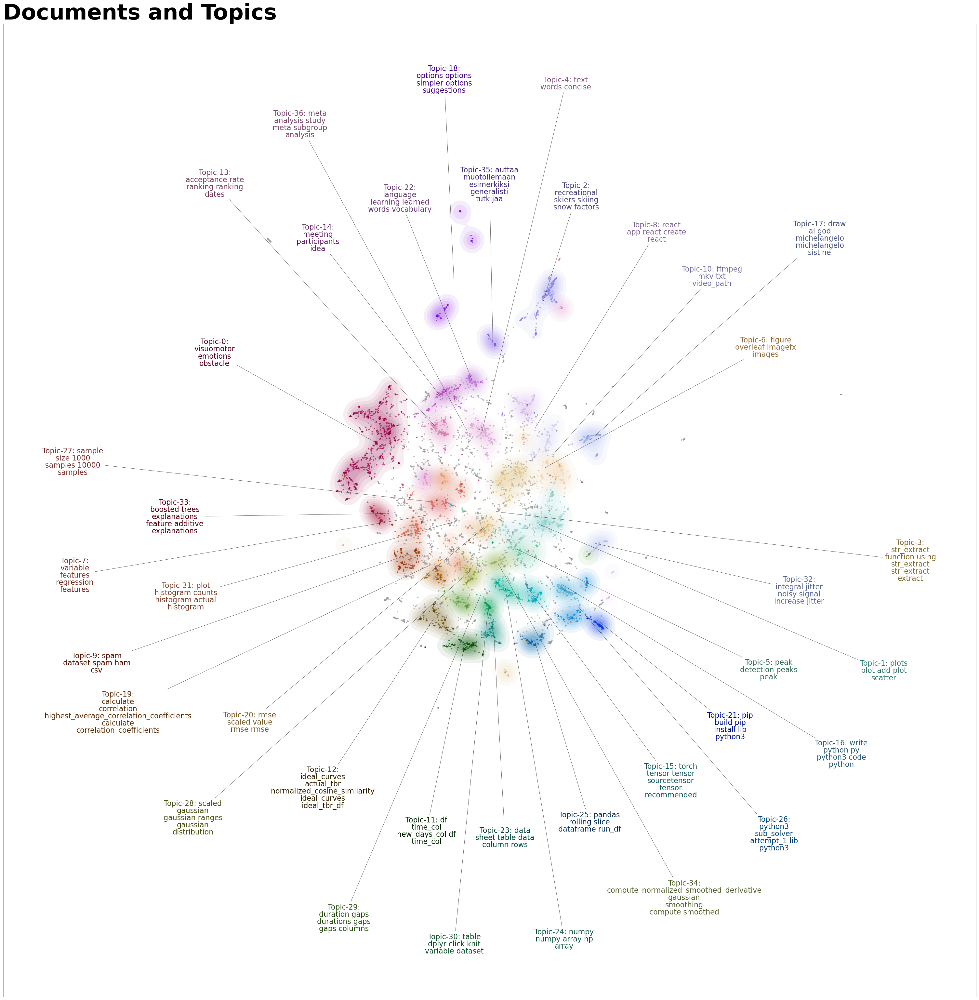

In [10]:
## Visualize the results
# Tag
POS_TAG = "POS_VERB_NOUN"
custom_labels = False
topic_model.set_topic_labels(topic_model.get_topic_info()[POS_TAG].apply(lambda x: str(x[:3])).tolist()) # Only take the first 3 letters of the POS tag

topic_model.get_topic_info()

fig = topic_model.visualize_documents(prompts_df["prompt"].tolist(),reduced_embeddings= reduced_embeddings, hide_annotations=True, custom_labels=custom_labels)
fig.write_html(f"figures/hiperprompts_documents_{POS_TAG if custom_labels else 'default'}.html")
fig

fig = topic_model.visualize_document_datamap(prompts_df["prompt"].tolist(), reduced_embeddings=reduced_embeddings, custom_labels=custom_labels, width = 3000, height = 3000)
fig.savefig(f"figures/hiperprompts_document_datamap_{POS_TAG if custom_labels else 'default'}.png")

In [11]:
## Fit the model for Pipa's prompts

hdbscan_model = HDBSCAN(min_cluster_size=20, min_samples= 10,  cluster_selection_method="eom", prediction_data=True)

topic_model= BERTopic(representation_model=representation_model, vectorizer_model=vectorizer_model,ctfidf_model=ctfidf_model, embedding_model=sentence_model, 
                                                    umap_model = umap_model, hdbscan_model = hdbscan_model, calculate_probabilities=False, verbose=True)

prompts_pipa_df['topic'] = topic_model.fit_transform(prompts_pipa_df["prompt"].tolist(), embeddings=np.array(prompts_pipa_df["embedding"].tolist()))[0]



2024-11-15 15:55:10,087 - BERTopic - Dimensionality - Fitting the dimensionality reduction algorithm
2024-11-15 15:55:14,243 - BERTopic - Dimensionality - Completed ✓
2024-11-15 15:55:14,244 - BERTopic - Cluster - Start clustering the reduced embeddings
2024-11-15 15:55:14,267 - BERTopic - Cluster - Completed ✓
2024-11-15 15:55:14,270 - BERTopic - Representation - Extracting topics from clusters using representation models.
2024-11-15 15:55:45,445 - BERTopic - Representation - Completed ✓


In [12]:
reduced_embeddings = UMAP(n_neighbors=10, n_components=2,
                            min_dist=0.0, metric='cosine').fit_transform(np.array(prompts_pipa_df["embedding"].tolist()))

,Topic,Count,Name,CustomName,Representation,POS_VERB,POS_NOUN,POS_VERB_NOUN,Representative_Docs
0,-1,221,-1_algorithmic thinking_research_creativity_mo...,"['critical thinking', 'scent detection', 'algo...","[algorithmic thinking, research, creativity, m...","[processes, qualitative, focus, characterized,...","[analysis, factors, thinking, network, cluster...","[critical thinking, scent detection, algorithm...","[I continue with the section of ""Limitations a..."
1,0,220,0_unitywebrequest_gamedatacontainer_using unit...,"['public int', 'public class', 'public void']","[unitywebrequest, gamedatacontainer, using uni...","[username, return, log, lives, count, register...","[php, int, www, file, username, json, string, ...","[public int, public class, public void, privat...",[I have the following datacollector class in m...
2,1,216,1_ai education_study_studies_research,"['computational thinking', 'artificial intelli...","[ai education, study, studies, research, educa...","[learning, personalized, reading, based, appro...","[education, teachers, learning, children, stud...","[computational thinking, artificial intelligen...","[In this methods section of my article:\n""\sec..."
3,2,86,2_formula assignments_diversity_plot_studydesi...,"['spurious edges', 'standard error', 'observat...","[formula assignments_diversity, plot, studydes...","[topicmodelling, squared, deleted, want, pvalu...","[df, test, cor, network, kendall, value, corre...","[spurious edges, standard error, observations ...",[The QQplot looks good and the cook distance p...
4,3,75,3_summarizing report_report structured_describ...,"['main stages', 'present tense', 'past tense']","[summarizing report, report structured, descri...","[report, permitted, think, written, describes,...","[article, tense, paragraph, report, subheading...","[main stages, present tense, past tense, ensur...",[My supervisor gave me the following coment on...
5,4,56,4_play patterns_players psychological_patterns...,"['play patterns', 'psychological profiles', 'i...","[play patterns, players psychological, pattern...","[play, informative, archetypes, player, train,...","[play, patterns, game, stage, agents, archetyp...","[play patterns, psychological profiles, inform...","[Based on the following objectives:\n""My PhD r..."
6,5,56,5_topic embeddings_bertopic framework_document...,"['minimum samples', 'produce embeddings', 'min...","[topic embeddings, bertopic framework, documen...","[clustering, verbose, embedding, extract, tuni...","[embeddings, self, documents, topics, topic, c...","[minimum samples, produce embeddings, minimum ...",[I feel that separating the content will make ...
7,6,56,6_information foraging_exploration prompts_use...,"['social cues', 'information foraging', 'gener...","[information foraging, exploration prompts, us...","[foraging, generated, keywords, shared, prompt...","[information, users, web, cues, landscapes, ex...","[social cues, information foraging, generated ...","[I feel the final sentences is a bit off, help..."
8,7,53,7_professional vision_higher educational_learn...,"['professional vision', 'using machine', 'psyc...","[professional vision, higher educational, lear...","[tell, linear, considering, learning, learn, e...","[emphasis, calculus, scenario, machine, vision...","[professional vision, using machine, psycholog...","[According to this scenario, elaborate but con..."
9,8,53,8_concepts textit_prompts aimed_generated conc...,"['prompt templates', 'prompting templates', 'i...","[concepts textit, prompts aimed, generated con...","[set, created, colored, provided, elaborate, g...","[categories, templates, scenario, cards, promp...","[prompt templates, prompting templates, intere...",[What do you think about my article's method s...


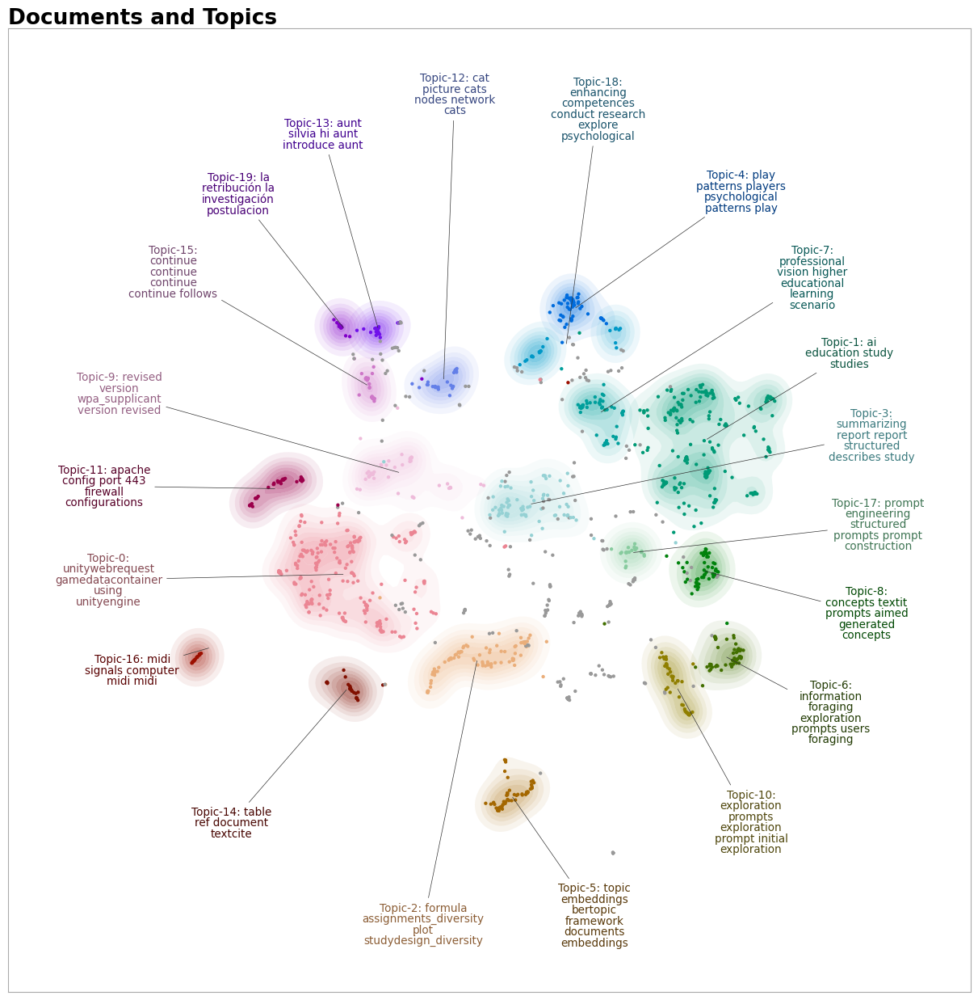

In [14]:
## Visualize the results for my own prompts

# Tag
POS_TAG = "POS_VERB_NOUN"
custom_labels = False
topic_model.set_topic_labels(topic_model.get_topic_info()[POS_TAG].apply(lambda x: str(x[:3])).tolist()) # Only take the first 3 letters of the POS tag

topic_model.get_topic_info()

fig = topic_model.visualize_documents(prompts_pipa_df["prompt"].tolist(),reduced_embeddings= reduced_embeddings, hide_annotations=True, custom_labels=custom_labels)
fig.write_html(f"figures/pipaprompts_documents_{POS_TAG if custom_labels else 'default'}.html")
fig

fig = topic_model.visualize_document_datamap(prompts_pipa_df["prompt"].tolist(), reduced_embeddings=reduced_embeddings, custom_labels=custom_labels)
fig.savefig(f"figures/pipaprompts_document_datamap_{POS_TAG if custom_labels else 'default'}.png")

In [15]:
hierarchical_topics = topic_model.hierarchical_topics(prompts_pipa_df["prompt"].tolist())

100%|██████████| 19/19 [00:05<00:00,  3.61it/s]


In [17]:
fig = topic_model.visualize_hierarchy(hierarchical_topics=hierarchical_topics, custom_labels=custom_labels)
fig.write_html(f"figures/hierarchical_topics_pipa_{POS_TAG if custom_labels else 'default'}.html")
fig

fig = topic_model.visualize_hierarchical_documents(prompts_pipa_df["prompt"].tolist(), hierarchical_topics,
                                                                      embeddings=np.array(prompts_pipa_df["embedding"].tolist()),
                                                                      reduced_embeddings=reduced_embeddings,
                                                                      custom_labels=custom_labels,
                                                                      hide_document_hover=False,
                                                                      hide_annotations=True)
fig.write_html(f"figures/hierarchical_documents_pipa_{POS_TAG if custom_labels else 'default'}.html")
fig